In [1]:
# import de pacotes
import pandas as pd

# plotar gráficos
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

# Combinaçao entre variaveis para plot em EDA
from itertools import combinations

# trabalhar com arquivo yaml
import yaml

# Save and load Modelos
import joblib

# Normalização de Escala
from sklearn.preprocessing import MinMaxScaler
# from sklearn.preprocessing import StandardScaler
# from sklearn.preprocessing import Normalizer

# Redução de dimensionalidade
from sklearn.decomposition import PCA

# VarianceThreshold
from sklearn.feature_selection import VarianceThreshold

# Preparar para treinamentos
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline

# Modelos de Predição
from sklearn import linear_model
from sklearn import svm
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import AdaBoostRegressor
# Métricas/Score de regresssão
from sklearn import metrics
import scipy.stats as stats

# Modelos de Classificação
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.ensemble import AdaBoostClassifier, RandomForestClassifier
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import GradientBoostingClassifier
# Relatorio de métricas de classificação
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay



In [2]:
# Definição de variváveis
train_path = '../data/PM_train.txt'
test_path = '../data/PM_test.txt'

target_prediction = 'RUL'
target_classification = 'close_to_failure'

# Read Features Confif YAML file
with open("../src/config/conf.yaml", 'r') as stream:
    conf_features = yaml.safe_load(stream)

In [3]:
# Coleta dos dados
data = pd.read_csv(train_path, sep=' ', header=None)
data.dropna(axis=1, how='all', inplace=True)

# Renomear os dados
for nameColumn in conf_features['data']['columns_names'].keys():
    first_columns = conf_features['data']['columns_names'][nameColumn]['first']
    last_columns = conf_features['data']['columns_names'][nameColumn]['last']
    for idx, nColumn in enumerate(range(first_columns, last_columns+1)):
        if first_columns == last_columns:
            data.rename(columns={nColumn: nameColumn}, inplace=True)
        else:
            data.rename(columns={nColumn: f'{nameColumn}{idx+1}'}, inplace=True)

# visualizar os dados originais
data

,Asset id,runtime,Setting1,Setting2,Setting3,Tag1,Tag2,Tag3,Tag4,Tag5,...,Tag12,Tag13,Tag14,Tag15,Tag16,Tag17,Tag18,Tag19,Tag20,Tag21
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,...,521.66,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,...,522.28,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,...,522.42,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,...,522.86,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,...,522.19,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20626,100,196,-0.0004,-0.0003,100.0,518.67,643.49,1597.98,1428.63,14.62,...,519.49,2388.26,8137.60,8.4956,0.03,397,2388,100.0,38.49,22.9735
20627,100,197,-0.0016,-0.0005,100.0,518.67,643.54,1604.50,1433.58,14.62,...,519.68,2388.22,8136.50,8.5139,0.03,395,2388,100.0,38.30,23.1594
20628,100,198,0.0004,0.0000,100.0,518.67,643.42,1602.46,1428.18,14.62,...,520.01,2388.24,8141.05,8.5646,0.03,398,2388,100.0,38.44,22.9333
20629,100,199,-0.0011,0.0003,100.0,518.67,643.23,1605.26,1426.53,14.62,...,519.67,2388.23,8139.29,8.5389,0.03,395,2388,100.0,38.29,23.0640


## EDA (Análise Exploratória de Dados)

In [4]:
# vizualizar resumo de informações sobre o dataset
print(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20631 entries, 0 to 20630
Data columns (total 26 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   Asset id  20631 non-null  int64  
 1   runtime   20631 non-null  int64  
 2   Setting1  20631 non-null  float64
 3   Setting2  20631 non-null  float64
 4   Setting3  20631 non-null  float64
 5   Tag1      20631 non-null  float64
 6   Tag2      20631 non-null  float64
 7   Tag3      20631 non-null  float64
 8   Tag4      20631 non-null  float64
 9   Tag5      20631 non-null  float64
 10  Tag6      20631 non-null  float64
 11  Tag7      20631 non-null  float64
 12  Tag8      20631 non-null  float64
 13  Tag9      20631 non-null  float64
 14  Tag10     20631 non-null  float64
 15  Tag11     20631 non-null  float64
 16  Tag12     20631 non-null  float64
 17  Tag13     20631 non-null  float64
 18  Tag14     20631 non-null  float64
 19  Tag15     20631 non-null  float64
 20  Tag16     20631 non-null  fl

In [5]:
# Criação do DataFrame
df = data.copy()

# Criando Features - Opções: Expansão de Time-series; ou métricas
# Esolha de prosseguir com criação de métricas: min, max, média e desvio padrão
window_size = 3
for coluna in data.columns.drop(['Asset id', 'runtime']):
    df[f'{coluna}-mean'] = ''
    df[f'{coluna}-min'] = ''
    df[f'{coluna}-max'] = ''
    df[f'{coluna}-std'] = ''

    for asset in df['Asset id'].unique():
        df.loc[df['Asset id'] == asset, f'{coluna}-mean'] = df.loc[df['Asset id'] == asset, coluna].rolling(window_size).mean()
        df.loc[df['Asset id'] == asset, f'{coluna}-min'] = df.loc[df['Asset id'] == asset, coluna].rolling(window_size).min()
        df.loc[df['Asset id'] == asset, f'{coluna}-max'] = df.loc[df['Asset id'] == asset, coluna].rolling(window_size).max()
        df.loc[df['Asset id'] == asset, f'{coluna}-std'] = df.loc[df['Asset id'] == asset, coluna].rolling(window_size).std()

df

,Asset id,runtime,Setting1,Setting2,Setting3,Tag1,Tag2,Tag3,Tag4,Tag5,...,Tag19-max,Tag19-std,Tag20-mean,Tag20-min,Tag20-max,Tag20-std,Tag21-mean,Tag21-min,Tag21-max,Tag21-std
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,...,100.0,0.0,39.003333,38.95,39.06,0.055076,23.3956,23.3442,23.4236,0.044573
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,...,100.0,0.0,38.943333,38.88,39.0,0.060277,23.380567,23.3442,23.4236,0.040118
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,...,100.0,0.0,38.91,38.88,38.95,0.036056,23.374167,23.3442,23.4044,0.030101
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20626,100,196,-0.0004,-0.0003,100.0,518.67,643.49,1597.98,1428.63,14.62,...,100.0,0.0,38.336667,38.14,38.49,0.178979,23.0994,22.9735,23.1923,0.113071
20627,100,197,-0.0016,-0.0005,100.0,518.67,643.54,1604.50,1433.58,14.62,...,100.0,0.0,38.31,38.14,38.49,0.175214,23.1084,22.9735,23.1923,0.117979
20628,100,198,0.0004,0.0000,100.0,518.67,643.42,1602.46,1428.18,14.62,...,100.0,0.0,38.41,38.3,38.49,0.098489,23.022067,22.9333,23.1594,0.120621
20629,100,199,-0.0011,0.0003,100.0,518.67,643.23,1605.26,1426.53,14.62,...,100.0,0.0,38.343333,38.29,38.44,0.083865,23.052233,22.9333,23.1594,0.113508


In [6]:
# Criação de features
## Remaining Useful Life (RUL)
df['RUL'] = [ df[df['Asset id']==dataRow['Asset id']]['runtime'].max() - dataRow['runtime'] for idx, dataRow in df.iterrows() ]

## Classificação Close to Failure
df['close_to_failure'] = False
df.loc[df['RUL']<20,'close_to_failure'] = True

## Composição do DataFrame
df.drop(columns='Asset id', inplace=True)
df.dropna(inplace=True)
df

,runtime,Setting1,Setting2,Setting3,Tag1,Tag2,Tag3,Tag4,Tag5,Tag6,...,Tag20-mean,Tag20-min,Tag20-max,Tag20-std,Tag21-mean,Tag21-min,Tag21-max,Tag21-std,RUL,close_to_failure
2,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,21.61,...,39.003333,38.95,39.06,0.055076,23.3956,23.3442,23.4236,0.044573,189,False
3,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,21.61,...,38.943333,38.88,39.0,0.060277,23.380567,23.3442,23.4236,0.040118,188,False
4,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,21.61,...,38.91,38.88,38.95,0.036056,23.374167,23.3442,23.4044,0.030101,187,False
5,6,-0.0043,-0.0001,100.0,518.67,642.10,1584.47,1398.37,14.62,21.61,...,38.92,38.88,38.98,0.052915,23.381733,23.3669,23.4044,0.019939,186,False
6,7,0.0010,0.0001,100.0,518.67,642.48,1592.32,1397.77,14.62,21.61,...,38.993333,38.9,39.1,0.100664,23.3829,23.3669,23.4044,0.019346,185,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20626,196,-0.0004,-0.0003,100.0,518.67,643.49,1597.98,1428.63,14.62,21.61,...,38.336667,38.14,38.49,0.178979,23.0994,22.9735,23.1923,0.113071,4,True
20627,197,-0.0016,-0.0005,100.0,518.67,643.54,1604.50,1433.58,14.62,21.61,...,38.31,38.14,38.49,0.175214,23.1084,22.9735,23.1923,0.117979,3,True
20628,198,0.0004,0.0000,100.0,518.67,643.42,1602.46,1428.18,14.62,21.61,...,38.41,38.3,38.49,0.098489,23.022067,22.9333,23.1594,0.120621,2,True
20629,199,-0.0011,0.0003,100.0,518.67,643.23,1605.26,1426.53,14.62,21.61,...,38.343333,38.29,38.44,0.083865,23.052233,22.9333,23.1594,0.113508,1,True


### Análise das Features

In [8]:
# Descrição estatísitca
df.describe()

,runtime,Setting1,Setting2,Setting3,Tag1,Tag2,Tag3,Tag4,Tag5,Tag6,...,Tag13,Tag14,Tag15,Tag16,Tag17,Tag18,Tag19,Tag20,Tag21,RUL
count,20431.000000,20431.000000,20431.000000,20431.0,20431.00,20431.00000,20431.000000,20431.000000,2.043100e+04,20431.000000,...,20431.000000,20431.000000,20431.000000,2.043100e+04,20431.000000,20431.0,20431.0,20431.000000,20431.000000,20431.000000
mean,109.858304,-0.000009,0.000002,100.0,518.67,642.68395,1590.559709,1408.996391,1.462000e+01,21.609807,...,2388.096555,8143.815963,8.442381,3.000000e-02,393.220596,2388.0,100.0,38.815030,23.288966,106.858304
std,68.390102,0.002188,0.000293,0.0,0.00,0.50036,6.132379,9.000301,5.329201e-15,0.001375,...,0.071953,19.142074,0.037526,1.387813e-17,1.548510,0.0,0.0,0.180671,0.108237,68.390102
min,3.000000,-0.008700,-0.000600,100.0,518.67,641.21000,1571.040000,1382.250000,1.462000e+01,21.600000,...,2387.880000,8099.940000,8.324900,3.000000e-02,388.000000,2388.0,100.0,38.140000,22.894200,0.000000
25%,54.000000,-0.001500,-0.000200,100.0,518.67,642.33000,1586.310000,1402.420000,1.462000e+01,21.610000,...,2388.040000,8133.270000,8.415000,3.000000e-02,392.000000,2388.0,100.0,38.700000,23.220700,51.000000
50%,105.000000,0.000000,0.000000,100.0,518.67,642.65000,1590.140000,1408.090000,1.462000e+01,21.610000,...,2388.090000,8140.580000,8.439200,3.000000e-02,393.000000,2388.0,100.0,38.830000,23.297100,102.000000
75%,157.000000,0.001500,0.000300,100.0,518.67,643.01000,1594.420000,1414.630000,1.462000e+01,21.610000,...,2388.140000,8148.375000,8.465800,3.000000e-02,394.000000,2388.0,100.0,38.940000,23.366100,154.000000
max,362.000000,0.008700,0.000600,100.0,518.67,644.53000,1616.910000,1441.490000,1.462000e+01,21.610000,...,2388.560000,8293.720000,8.584800,3.000000e-02,400.000000,2388.0,100.0,39.430000,23.618400,359.000000


In [8]:
# plotar histogramas das variáveis, 
# com finalidade para oberservar o comportamento de suas distribuição
for col in data.drop(columns=['Asset id']).columns:
    fig = px.histogram(data, x = col)
    fig.show()

In [9]:
# Preparar dado para exploração sem novas Features
## Remaining Useful Life (RUL)
df_eda = data.copy()

df_eda['RUL'] = [ df_eda[df_eda['Asset id']==dataRow['Asset id']]['runtime'].max() - dataRow['runtime'] for idx, dataRow in df_eda.iterrows() ]

## Classificação Close to Failure
df_eda['close_to_failure'] = False
df_eda.loc[df_eda['RUL']<20,'close_to_failure'] = True

# Composição do Data Frame
df_eda.drop(columns='Asset id', inplace=True)
df_eda.dropna(inplace=True)


C:\Users\lucas\AppData\Local\Temp\ipykernel_9844\3720798149.py:3: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.



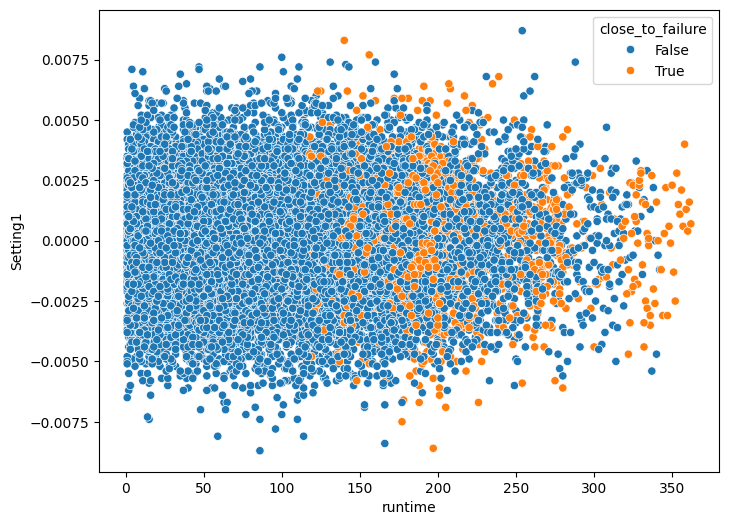

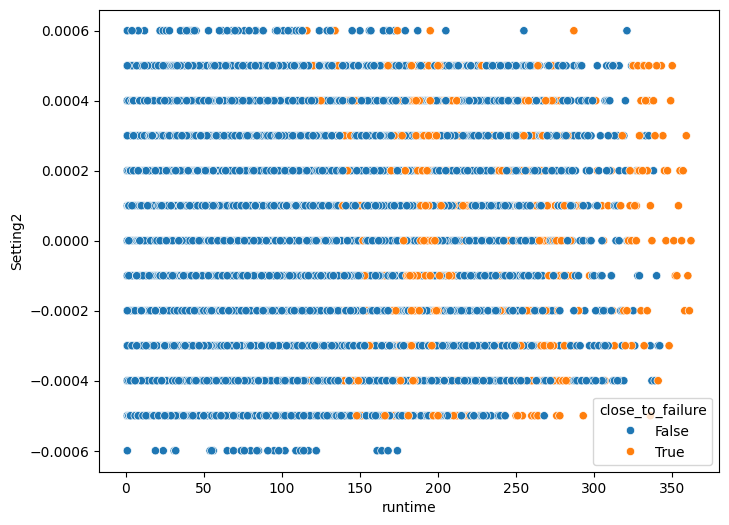

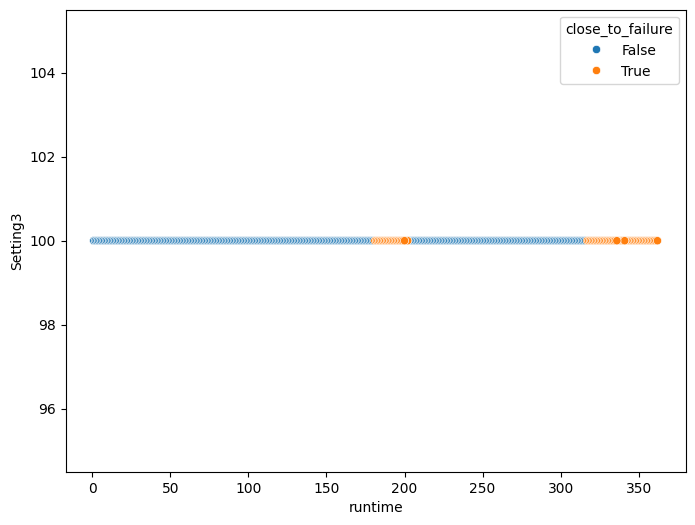

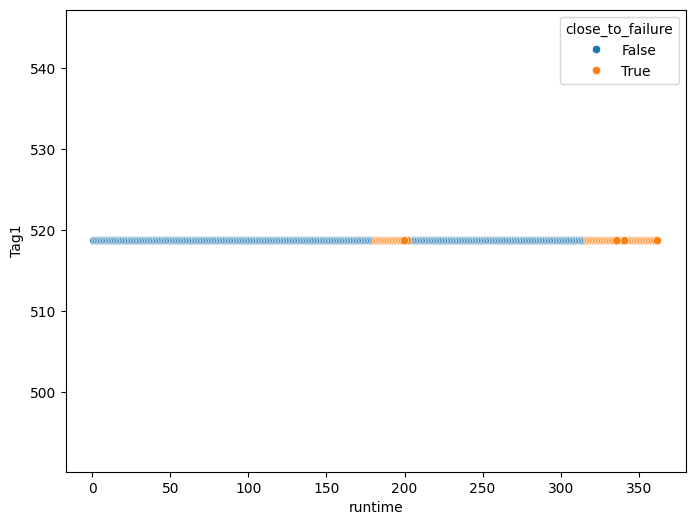

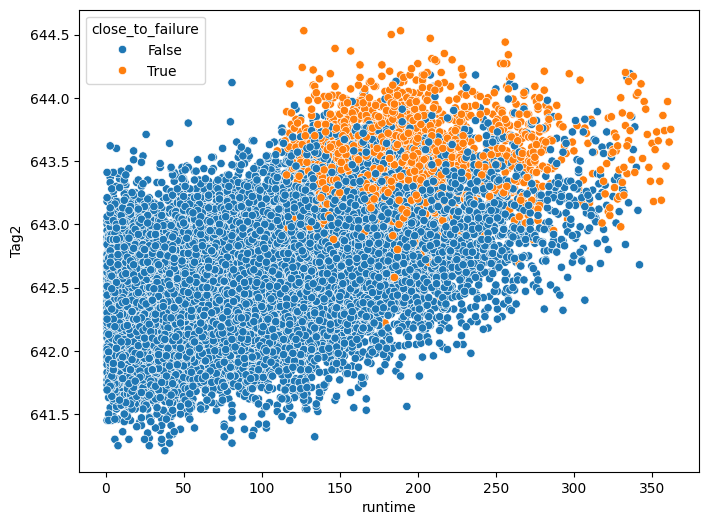

...

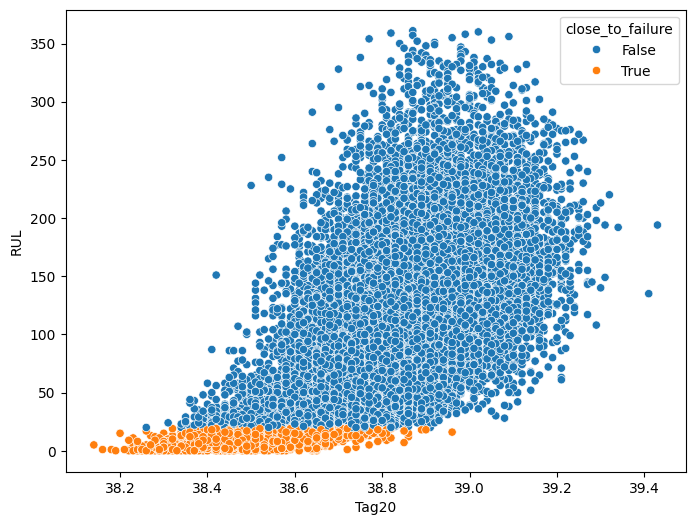

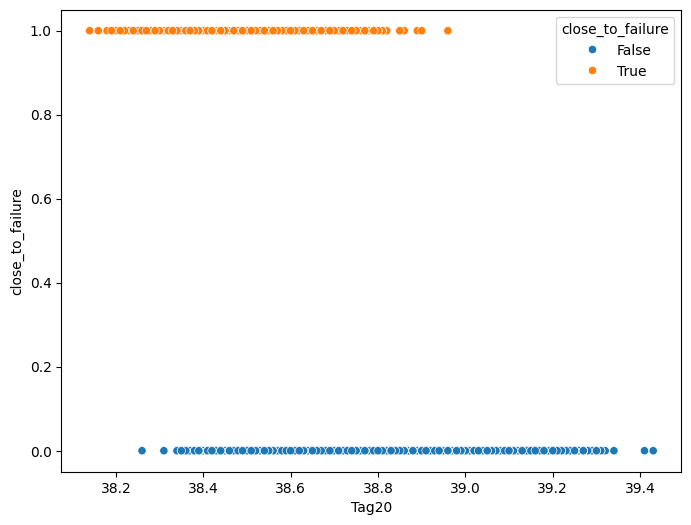

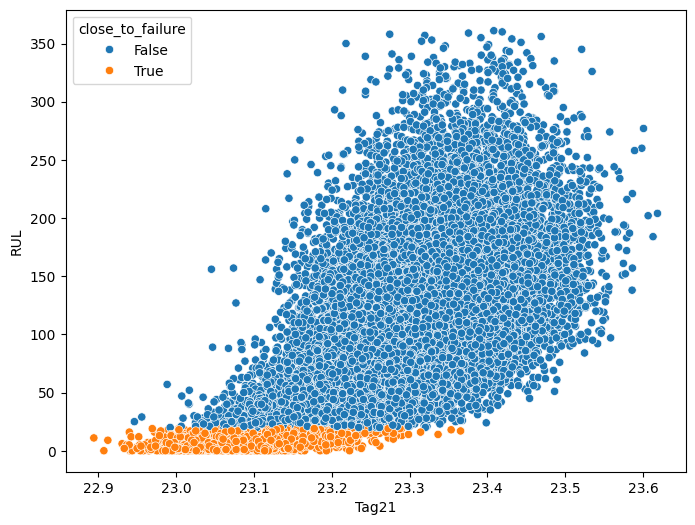

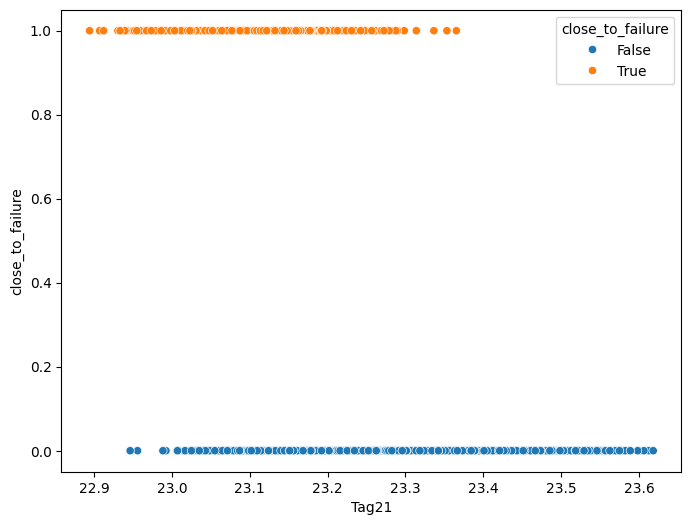

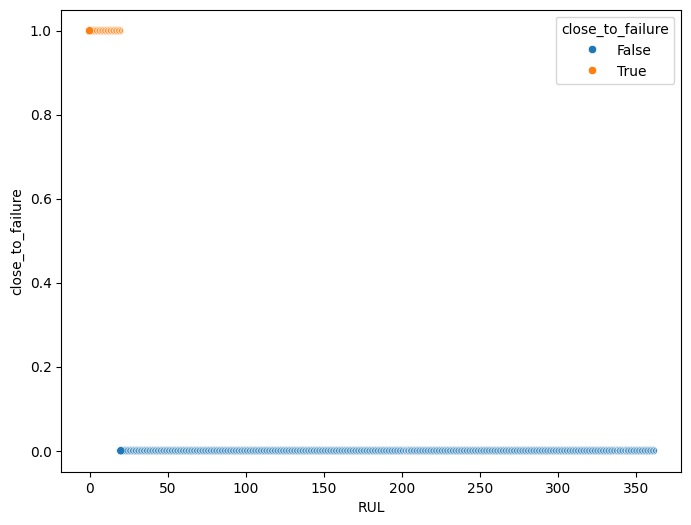

In [10]:
for gx, gy in combinations(df_eda.columns, 2):
    # plotar grafico realcionando 2 variáveis
    fig = plt.figure(figsize = (8,6))
    sns.scatterplot(df_eda,
                    x = gx, 
                    y = gy,
                    hue = target_classification
                )
    fig.figure.savefig(f"./EDA Results/Scatter Plot - Classificação/{gx}x{gy}.png")
    # plt.show()

In [ ]:
for gx, gy in combinations(df_eda.columns, 2):
    # plotar grafico realcionando 2 variáveis
    fig = plt.figure(figsize = (8,6))
    sns.scatterplot(df_eda,
                    x = gx, 
                    y = gy,
                    hue = target_prediction,
                    palette='viridis'
                )
    fig.figure.savefig(f"./EDA Results/Scatter Plot - RUL/{gx}x{gy}.png")
    # plt.show()

In [16]:
# Normalizar MinMax Scaler
# finalidade de obsarvar comparativamente variabilidade
scaler = MinMaxScaler()

df_eda = scaler.fit_transform(data.drop(columns=['Asset id']))
df_eda = pd.DataFrame(df_eda, columns=data.drop(columns=['Asset id']).columns)

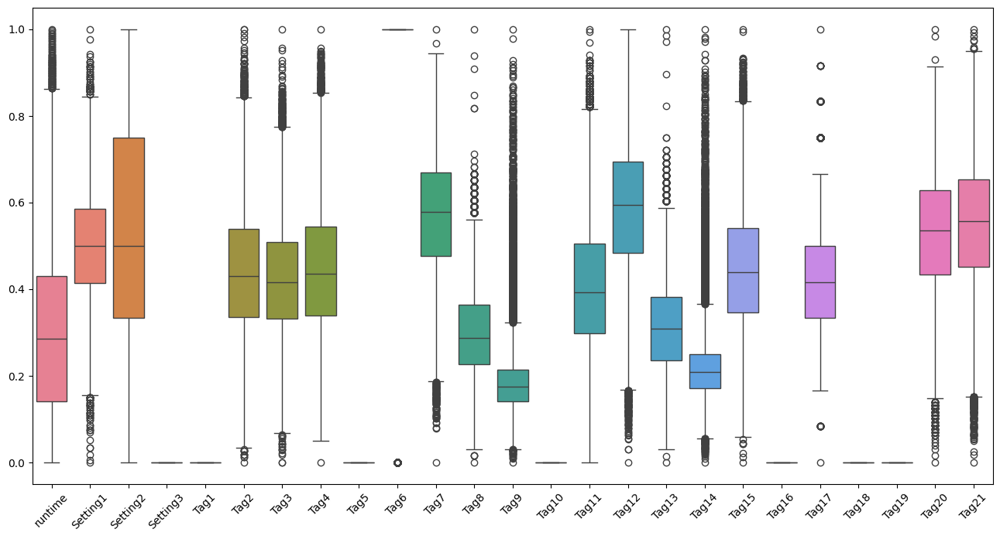

In [17]:
# Gráfico em Boxplot - Todas as variáveis
plot = plt.figure(figsize=(16, 8))
ax = sns.boxplot(df_eda)
plt.setp(ax.get_xticklabels(), rotation=45)
plt.show()
plot.figure.savefig("./EDA Results/features_boxplot_preVarianceThreshold.png")

In [18]:
# Selecionar apenas as Colunas que apresentam Variancias a partir de um Threshold
selector = VarianceThreshold()
selector = selector.fit(df_eda)
df_eda = pd.DataFrame(df_eda, columns=df_eda.columns[selector.get_support()])

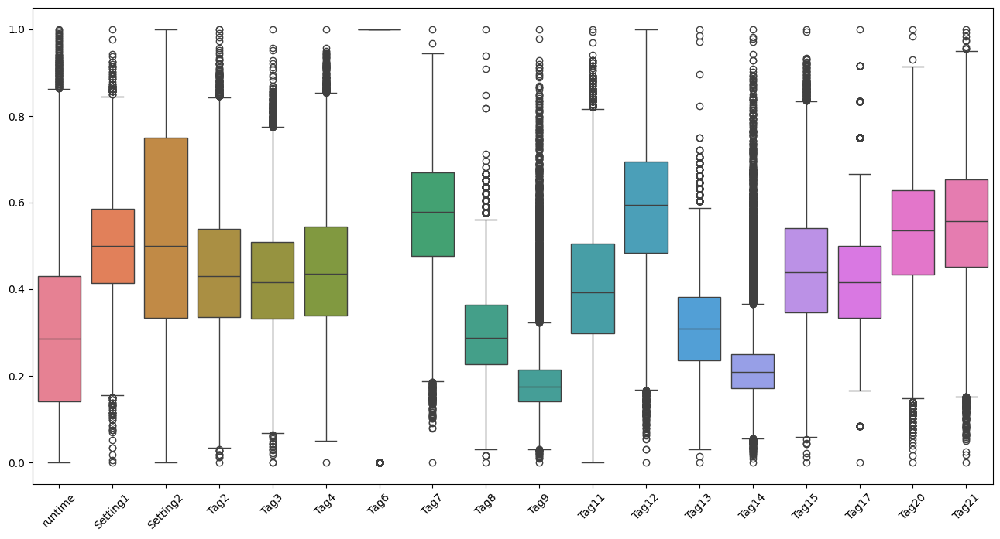

In [19]:
# Gráfico em Boxplot - Variáveis selecionadas pela VarianceThreshold
plot = plt.figure(figsize=(16, 8))
ax = sns.boxplot(df_eda)
plt.setp(ax.get_xticklabels(), rotation=45)
plt.show()
plot.figure.savefig("./EDA Results/features_boxplot.png")

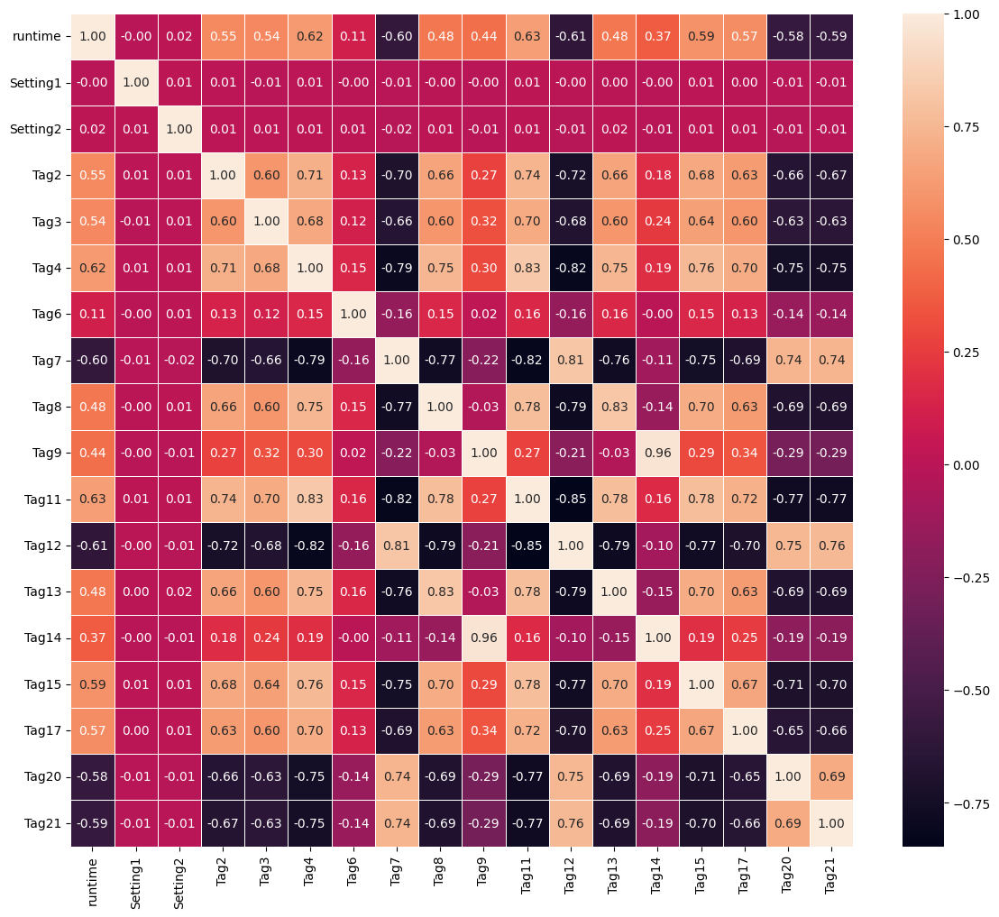

In [20]:
# Correlação entre features
plt.figure(figsize=(14,12))
plot = sns.heatmap(df_eda.corr(method = 'pearson'),annot=True,fmt=".2f", linewidth=.5)
plt.show()
plot.figure.savefig(f"./EDA Results/feature_correlation.png")

# Treinamento de Modelos

### Classificação
##### Classificação para fornecer a informação se o ativo irá falhar após mais de 20 ciclos (probabilidade 0-1) 

In [18]:
# Preparando o data set para executar treinamento de classificação
# Colunas das variaveis utilizadas nas classificação
Y = df[target_classification]
X = df.drop(columns=[target_classification, target_prediction])

X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.33, random_state=42)

In [19]:
# organizaçao de nomes dos modelos testados
names = [
    "Nearest Neighbors",
    "SVM",
    "Decision Tree",
    "Random Forest",
    "Neural Net",
    "AdaBoost",
    "Naive Bayes",
    "QDA",
    "GradientBoosting"
]

# lista dos modelos testados
classifiers = [
    KNeighborsClassifier(3),
    SVC(gamma='auto', random_state=42, probability=True),
    DecisionTreeClassifier(max_depth=5, random_state=42),
    RandomForestClassifier(
        max_depth=5, n_estimators=10, random_state=42
    ),
    MLPClassifier(alpha=1, max_iter=1000, random_state=42),
    AdaBoostClassifier(random_state=42),
    GaussianNB(),
    QuadraticDiscriminantAnalysis(reg_param=0.1),
    GradientBoostingClassifier(n_estimators=100, max_depth=10, random_state=42)
]

=======================Nearest Neighbors==================================
Train
              precision    recall  f1-score   support

       False       0.99      1.00      1.00     12363
        True       0.96      0.95      0.95      1325

    accuracy                           0.99     13688
   macro avg       0.98      0.97      0.98     13688
weighted avg       0.99      0.99      0.99     13688


Test
              precision    recall  f1-score   support

       False       0.99      0.99      0.99      6068
        True       0.91      0.88      0.89       675

    accuracy                           0.98      6743
   macro avg       0.95      0.93      0.94      6743
weighted avg       0.98      0.98      0.98      6743



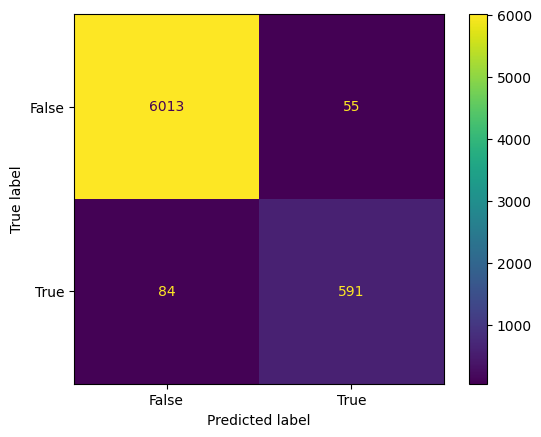

=======================SVM==================================
Train
              precision    recall  f1-score   support

       False       1.00      1.00      1.00     12363
        True       1.00      0.98      0.99      1325

    accuracy                           1.00     13688
   macro avg       1.00      0.99      0.99     13688
weighted avg       1.00      1.00      1.00     13688


Test
              precision    recall  f1-score   support

       False       0.96      1.00      0.98      6068
        True       0.96      0.63      0.76       675

    accuracy                           0.96      6743
   macro avg       0.96      0.81      0.87      6743
weighted avg       0.96      0.96      0.96      6743



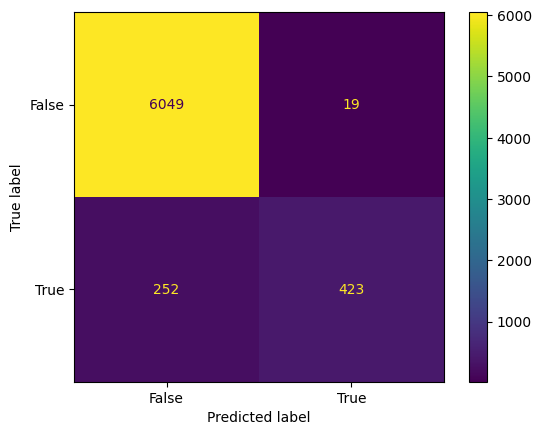

=======================Decision Tree==================================
Train
              precision    recall  f1-score   support

       False       0.99      0.99      0.99     12363
        True       0.90      0.88      0.89      1325

    accuracy                           0.98     13688
   macro avg       0.95      0.93      0.94     13688
weighted avg       0.98      0.98      0.98     13688


Test
              precision    recall  f1-score   support

       False       0.98      0.99      0.98      6068
        True       0.86      0.86      0.86       675

    accuracy                           0.97      6743
   macro avg       0.92      0.92      0.92      6743
weighted avg       0.97      0.97      0.97      6743



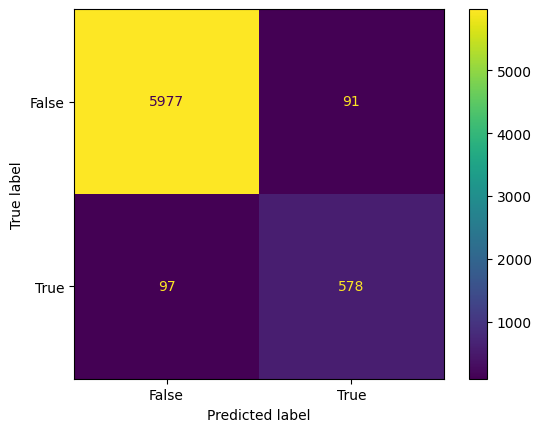

=======================Random Forest==================================
Train
              precision    recall  f1-score   support

       False       0.99      0.99      0.99     12363
        True       0.93      0.89      0.91      1325

    accuracy                           0.98     13688
   macro avg       0.96      0.94      0.95     13688
weighted avg       0.98      0.98      0.98     13688


Test
              precision    recall  f1-score   support

       False       0.99      0.99      0.99      6068
        True       0.90      0.88      0.89       675

    accuracy                           0.98      6743
   macro avg       0.94      0.93      0.94      6743
weighted avg       0.98      0.98      0.98      6743



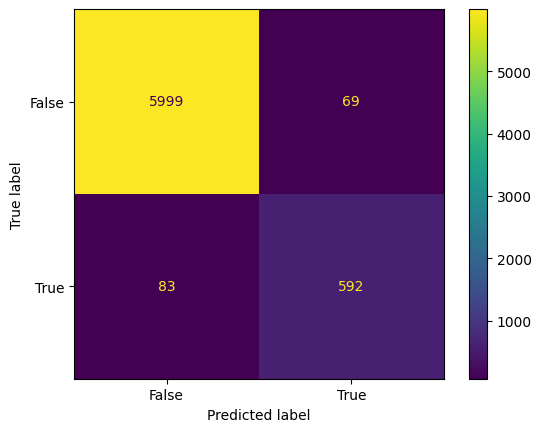

=======================Neural Net==================================
Train
              precision    recall  f1-score   support

       False       0.90      1.00      0.95     12363
        True       0.79      0.01      0.03      1325

    accuracy                           0.90     13688
   macro avg       0.85      0.51      0.49     13688
weighted avg       0.89      0.90      0.86     13688


Test
              precision    recall  f1-score   support

       False       0.90      1.00      0.95      6068
        True       0.62      0.01      0.01       675

    accuracy                           0.90      6743
   macro avg       0.76      0.50      0.48      6743
weighted avg       0.87      0.90      0.85      6743



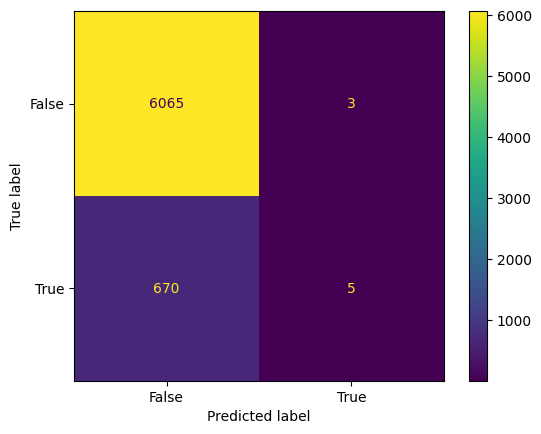

=======================AdaBoost==================================
Train
              precision    recall  f1-score   support

       False       0.99      0.99      0.99     12363
        True       0.91      0.89      0.90      1325

    accuracy                           0.98     13688
   macro avg       0.95      0.94      0.95     13688
weighted avg       0.98      0.98      0.98     13688


Test
              precision    recall  f1-score   support

       False       0.99      0.99      0.99      6068
        True       0.88      0.88      0.88       675

    accuracy                           0.98      6743
   macro avg       0.93      0.93      0.93      6743
weighted avg       0.98      0.98      0.98      6743



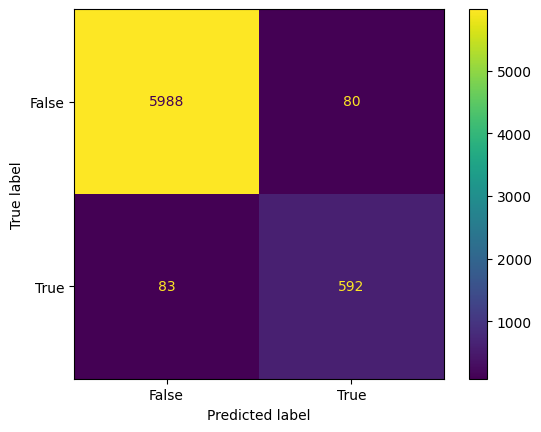

=======================Naive Bayes==================================
Train
              precision    recall  f1-score   support

       False       1.00      0.92      0.96     12363
        True       0.58      1.00      0.73      1325

    accuracy                           0.93     13688
   macro avg       0.79      0.96      0.85     13688
weighted avg       0.96      0.93      0.94     13688


Test
              precision    recall  f1-score   support

       False       1.00      0.92      0.96      6068
        True       0.57      1.00      0.73       675

    accuracy                           0.92      6743
   macro avg       0.78      0.96      0.84      6743
weighted avg       0.96      0.92      0.93      6743



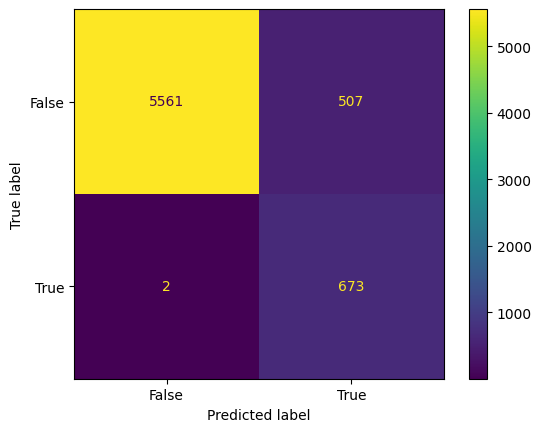

=======================QDA==================================
Train
              precision    recall  f1-score   support

       False       0.99      0.97      0.98     12363
        True       0.77      0.91      0.83      1325

    accuracy                           0.96     13688
   macro avg       0.88      0.94      0.91     13688
weighted avg       0.97      0.96      0.97     13688


Test
              precision    recall  f1-score   support

       False       0.99      0.97      0.98      6068
        True       0.78      0.88      0.83       675

    accuracy                           0.96      6743
   macro avg       0.89      0.93      0.91      6743
weighted avg       0.97      0.96      0.97      6743



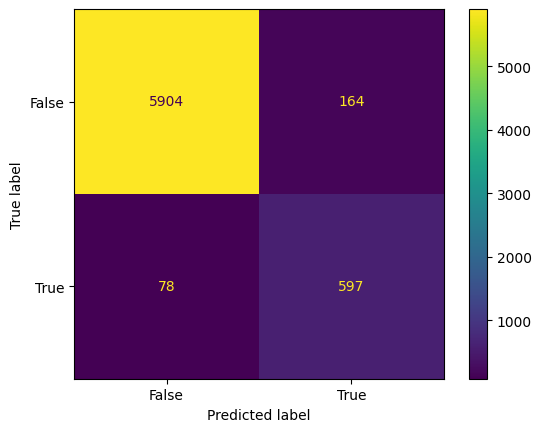

=======================GradientBoosting==================================
Train
              precision    recall  f1-score   support

       False       1.00      1.00      1.00     12363
        True       1.00      1.00      1.00      1325

    accuracy                           1.00     13688
   macro avg       1.00      1.00      1.00     13688
weighted avg       1.00      1.00      1.00     13688


Test
              precision    recall  f1-score   support

       False       0.99      0.99      0.99      6068
        True       0.91      0.89      0.90       675

    accuracy                           0.98      6743
   macro avg       0.95      0.94      0.94      6743
weighted avg       0.98      0.98      0.98      6743



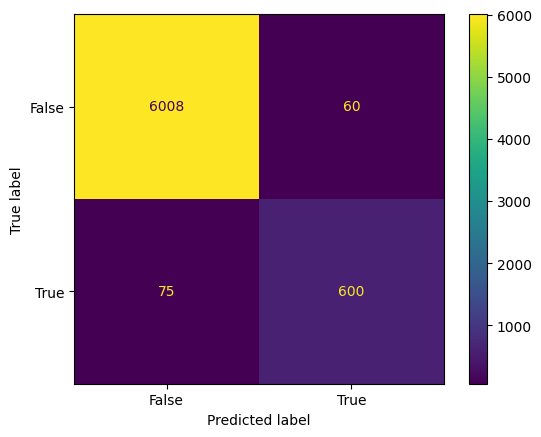

In [20]:
# metrica para valaiar razao entre F1-score
f1score_ration = pd.DataFrame([], columns=names)

# Iteração entre cada modelo
for name, clf_model in zip(names, classifiers):
    
    # # Variance Threshold
    # # Possibilidade de trabalhar com VarianceThreshold
    # variance_selector = VarianceThreshold()

    # # PCA
    # # Possibilidade de trabalhar com reduçao de dimensionaldiade
    # pca = PCA(n_components=5)
    
    # criando pipeline com modelo e feature selection
    pipeline = Pipeline([
        # ('variance', variance_selector),
        # ('pca', pca),
        ('predict', clf_model)
    ])

    # realizando o treinmaneto da classificação
    clf = pipeline.fit(X_train, y_train)
    joblib.dump(clf, f'./models/classification_{name}.pkl')

    # capitura de score nos dados de teste
    score = clf.score(X_test, y_test)
    
    # criando report de scores/resultados
    report_train_data = classification_report(y_train, clf.predict(X_train))
    report_test_data = classification_report(y_test, clf.predict(X_test), output_dict=True)
    try:
        f1score_ration.loc[0,name] = report_test_data['False']['f1-score']/report_test_data['True']['f1-score']
    except:
        continue
    report_test_data = classification_report(y_test, clf.predict(X_test))

    # printar os resultados do modelo de classificação
    print(f'======================={name}==================================')
    print('Train')
    print(report_train_data)
    print('')
    print('Test')
    print(report_test_data)

    # confusion matrix
    predictions = clf.predict(X_test)
    cm = confusion_matrix(y_test, predictions, labels=clf.classes_)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              display_labels=clf.classes_)
    disp.plot()
    plt.show()

In [21]:
f1score_ration

,Nearest Neighbors,SVM,Decision Tree,Random Forest,Neural Net,AdaBoost,Naive Bayes,QDA,GradientBoosting
0,1.104827,1.291403,1.144628,1.114262,64.709756,1.122393,1.317846,1.178527,1.10014


## Regressão
#### previsão de quantos ciclos restantes o ativo ainda tem (RUL)

In [22]:
# Preparando o dataset para executar treinamento de predição/regressão
# colunas das variáveis utilizadas na prediçao/regressão
Y = df[target_prediction]
X = df.drop(columns=[target_classification, target_prediction])

X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.33, random_state=42)

In [23]:
# organizaçao de nomes dos modelos testados
names = [
    "Linear",
    "Ridge",
    "LARS Lasso",
    "SRV",
    "RandomForestRegressor",
    "GradientBoostingRegressor",
    "AdaBoostRegressor"
]

# lista dos modelos testados
regression_models = [
    linear_model.LinearRegression(),
    linear_model.Ridge(alpha=.5),
    linear_model.LassoLars(alpha=.1),
    svm.SVR(),
    RandomForestRegressor(max_depth=20, random_state=42),
    GradientBoostingRegressor(random_state=42),
    AdaBoostRegressor(random_state=42, n_estimators=100)
]

=======================Linear==================================
Train
Mean Absolute Error (MAE) =  30.794054741047315
Mean Squared Error (MSE) =  1620.4793196450812
Root Mean Squared Error (RMSE) =  40.255177550783216
R-squared (R2) Score =  0.6574593531705728

Test
Mean Absolute Error (MAE) =  30.37233631902608
Mean Squared Error (MSE) =  1571.1787807432227
Root Mean Squared Error (RMSE) =  39.63809759238229
R-squared (R2) Score =  0.6557807605093822


c:\Users\lucas\AppData\Local\Programs\Python\Python312\Lib\site-packages\scipy\stats\_axis_nan_policy.py:586: UserWarning:

scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 6743.



ShapiroResult(statistic=np.float64(0.9528781282315978), pvalue=np.float64(4.483532039428014e-42))

AndersonResult(statistic=np.float64(69.68380067540602), critical_values=array([0.576, 0.656, 0.787, 0.917, 1.091]), significance_level=array([15. , 10. ,  5. ,  2.5,  1. ]), fit_result=  params: FitParams(loc=np.float64(-0.05585493483335066), scale=np.float64(39.64099776661952))
 success: True
 message: '`anderson` successfully fit the distribution to the data.')

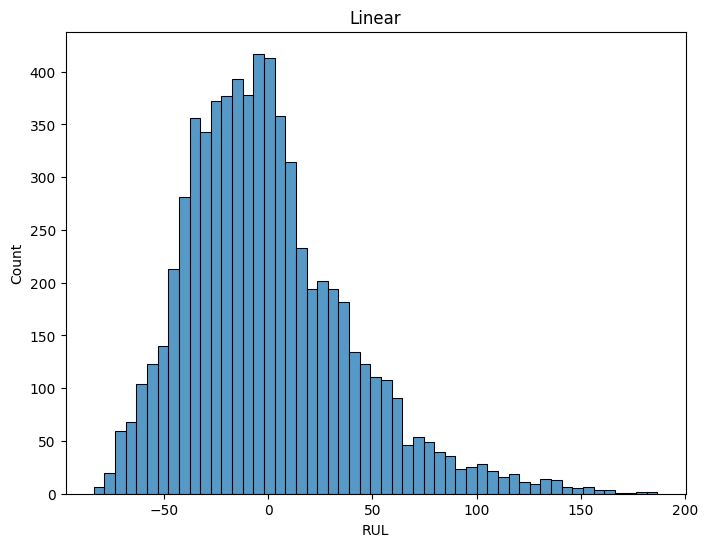

=======================Ridge==================================
Train
Mean Absolute Error (MAE) =  30.837872859706597
Mean Squared Error (MSE) =  1625.345362188172
Root Mean Squared Error (RMSE) =  40.31557220464782
R-squared (R2) Score =  0.656430757902492

Test
Mean Absolute Error (MAE) =  30.368938909970364
Mean Squared Error (MSE) =  1571.1672203561795
Root Mean Squared Error (RMSE) =  39.637951767922864
R-squared (R2) Score =  0.6557832931986503


c:\Users\lucas\AppData\Local\Programs\Python\Python312\Lib\site-packages\scipy\stats\_axis_nan_policy.py:586: UserWarning:

scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 6743.



ShapiroResult(statistic=np.float64(0.952488221124808), pvalue=np.float64(3.3305943868902057e-42))

AndersonResult(statistic=np.float64(70.35709249209867), critical_values=array([0.576, 0.656, 0.787, 0.917, 1.091]), significance_level=array([15. , 10. ,  5. ,  2.5,  1. ]), fit_result=  params: FitParams(loc=np.float64(-0.0686558650110521), scale=np.float64(39.640831824533485))
 success: True
 message: '`anderson` successfully fit the distribution to the data.')

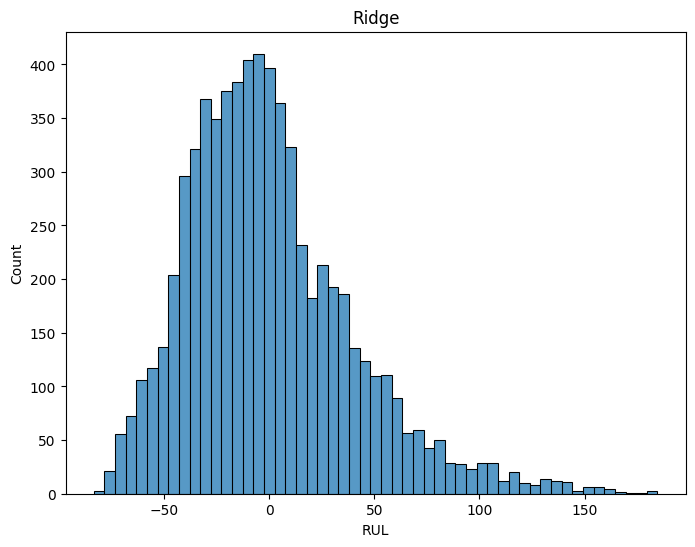

=======================LARS Lasso==================================
Train
Mean Absolute Error (MAE) =  30.923411373733224
Mean Squared Error (MSE) =  1633.0540488936163
Root Mean Squared Error (RMSE) =  40.41106344670499
R-squared (R2) Score =  0.6548012779712908

Test
Mean Absolute Error (MAE) =  30.41636397655865
Mean Squared Error (MSE) =  1574.2330427089962
Root Mean Squared Error (RMSE) =  39.676605735735464
R-squared (R2) Score =  0.6551116223158493


c:\Users\lucas\AppData\Local\Programs\Python\Python312\Lib\site-packages\scipy\stats\_axis_nan_policy.py:586: UserWarning:

scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 6743.



ShapiroResult(statistic=np.float64(0.9520982929272834), pvalue=np.float64(2.4789530992673836e-42))

AndersonResult(statistic=np.float64(71.63200472852986), critical_values=array([0.576, 0.656, 0.787, 0.917, 1.091]), significance_level=array([15. , 10. ,  5. ,  2.5,  1. ]), fit_result=  params: FitParams(loc=np.float64(-0.12435635324391553), scale=np.float64(39.679353225061625))
 success: True
 message: '`anderson` successfully fit the distribution to the data.')

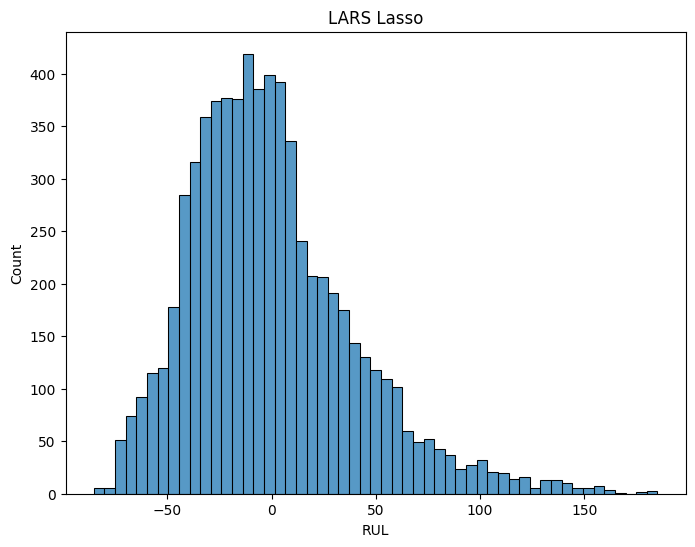

=======================SRV==================================
Train
Mean Absolute Error (MAE) =  56.370213649149235
Mean Squared Error (MSE) =  4735.688378370728
Root Mean Squared Error (RMSE) =  68.81633801918501
R-squared (R2) Score =  -0.0010407048360223659

Test
Mean Absolute Error (MAE) =  55.74092189268009
Mean Squared Error (MSE) =  4552.875665555313
Root Mean Squared Error (RMSE) =  67.47500030052103
R-squared (R2) Score =  0.0025403739532076086


c:\Users\lucas\AppData\Local\Programs\Python\Python312\Lib\site-packages\scipy\stats\_axis_nan_policy.py:586: UserWarning:

scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 6743.



ShapiroResult(statistic=np.float64(0.968330121432696), pvalue=np.float64(4.2960988720860665e-36))

AndersonResult(statistic=np.float64(43.88387472701106), critical_values=array([0.576, 0.656, 0.787, 0.917, 1.091]), significance_level=array([15. , 10. ,  5. ,  2.5,  1. ]), fit_result=  params: FitParams(loc=np.float64(2.6397310846598026), scale=np.float64(67.42834531754988))
 success: True
 message: '`anderson` successfully fit the distribution to the data.')

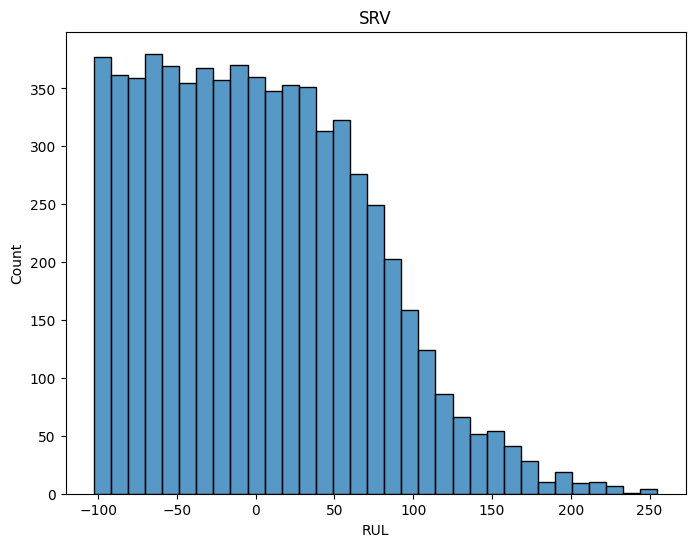

=======================RandomForestRegressor==================================
Train
Mean Absolute Error (MAE) =  8.343778397085316
Mean Squared Error (MSE) =  145.18103175614104
Root Mean Squared Error (RMSE) =  12.049109168570972
R-squared (R2) Score =  0.9693112994888425

Test
Mean Absolute Error (MAE) =  20.719788551238096
Mean Squared Error (MSE) =  909.5754437077741
Root Mean Squared Error (RMSE) =  30.15916848501918
R-squared (R2) Score =  0.800727090175997


c:\Users\lucas\AppData\Local\Programs\Python\Python312\Lib\site-packages\scipy\stats\_axis_nan_policy.py:586: UserWarning:

scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 6743.



ShapiroResult(statistic=np.float64(0.9323240475134598), pvalue=np.float64(6.116272513198312e-48))

AndersonResult(statistic=np.float64(126.95404018587578), critical_values=array([0.576, 0.656, 0.787, 0.917, 1.091]), significance_level=array([15. , 10. ,  5. ,  2.5,  1. ]), fit_result=  params: FitParams(loc=np.float64(-0.6040747901650868), scale=np.float64(30.155354334585127))
 success: True
 message: '`anderson` successfully fit the distribution to the data.')

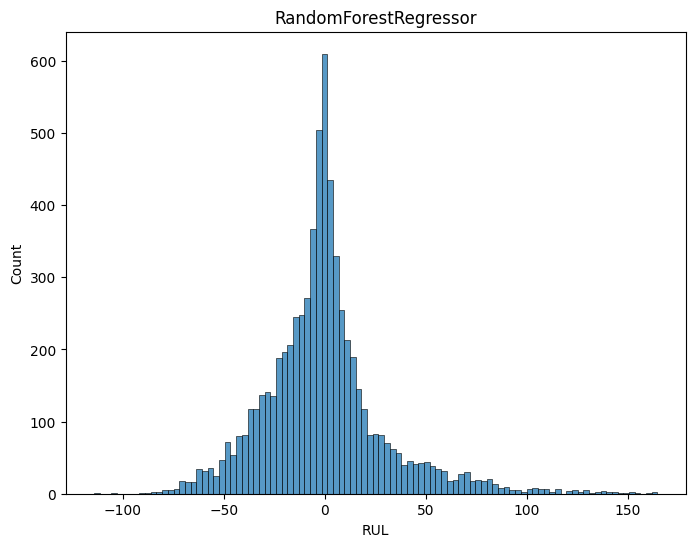

=======================GradientBoostingRegressor==================================
Train
Mean Absolute Error (MAE) =  23.648534504884022
Mean Squared Error (MSE) =  1100.442552583315
Root Mean Squared Error (RMSE) =  33.172918963867424
R-squared (R2) Score =  0.7673859214426298

Test
Mean Absolute Error (MAE) =  24.26698164761598
Mean Squared Error (MSE) =  1168.0393123516494
Root Mean Squared Error (RMSE) =  34.17659012177267
R-squared (R2) Score =  0.7441019387986899


c:\Users\lucas\AppData\Local\Programs\Python\Python312\Lib\site-packages\scipy\stats\_axis_nan_policy.py:586: UserWarning:

scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 6743.



ShapiroResult(statistic=np.float64(0.9408670446414609), pvalue=np.float64(1.0453857658911998e-45))

AndersonResult(statistic=np.float64(104.1839816971542), critical_values=array([0.576, 0.656, 0.787, 0.917, 1.091]), significance_level=array([15. , 10. ,  5. ,  2.5,  1. ]), fit_result=  params: FitParams(loc=np.float64(-0.04477991336246486), scale=np.float64(34.17909529238396))
 success: True
 message: '`anderson` successfully fit the distribution to the data.')

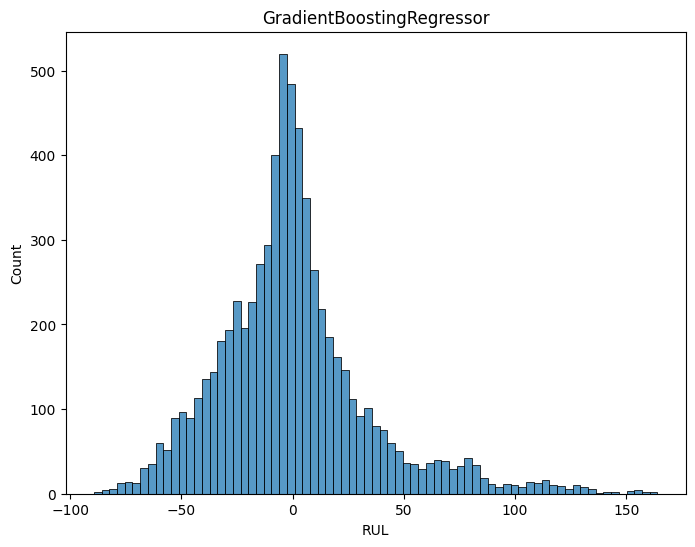

=======================AdaBoostRegressor==================================
Train
Mean Absolute Error (MAE) =  32.44357983625072
Mean Squared Error (MSE) =  1585.681103879519
Root Mean Squared Error (RMSE) =  39.82061154577512
R-squared (R2) Score =  0.664815080079483

Test
Mean Absolute Error (MAE) =  32.35431736716658
Mean Squared Error (MSE) =  1595.8033868771372
Root Mean Squared Error (RMSE) =  39.94750789319826
R-squared (R2) Score =  0.6503859172871727


c:\Users\lucas\AppData\Local\Programs\Python\Python312\Lib\site-packages\scipy\stats\_axis_nan_policy.py:586: UserWarning:

scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 6743.



ShapiroResult(statistic=np.float64(0.9701789295878454), pvalue=np.float64(3.1394555285597103e-35))

AndersonResult(statistic=np.float64(64.66077542549374), critical_values=array([0.576, 0.656, 0.787, 0.917, 1.091]), significance_level=array([15. , 10. ,  5. ,  2.5,  1. ]), fit_result=  params: FitParams(loc=np.float64(-14.913956228464732), scale=np.float64(37.061853720821745))
 success: True
 message: '`anderson` successfully fit the distribution to the data.')

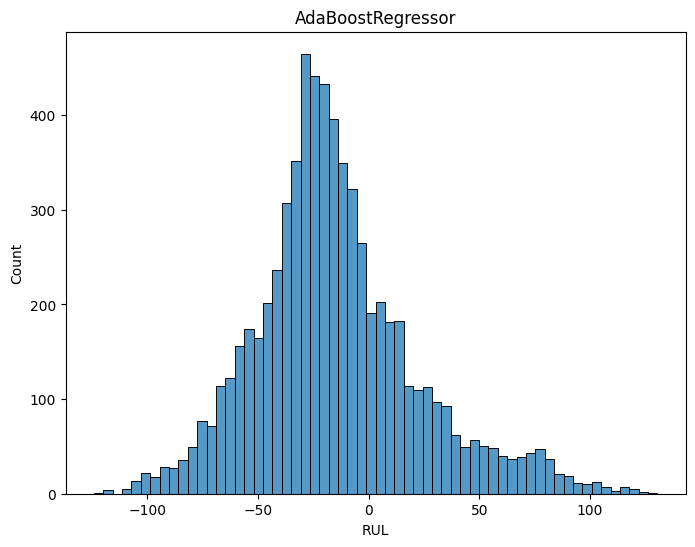

In [24]:
# metrica para valaiar razao entre F1-score
f1score_ration = pd.DataFrame([], columns=names)

# Iteração entre cada modelo
for name, reg_model in zip(names, regression_models):

    # # MinMaxScaler
    # # Possibilidade de trabalhar com ajustando dimensão e escala
    # scaler = MinMaxScaler()
    
    # # Variance Threshold
    # # Possibilidade de trabalhar com VarianceThreshold
    # variance_selector = VarianceThreshold()

    # # PCA
    # # Possibilidade de trabalhar com reduçao de dimensionaldiade
    # pca = PCA(n_components=5)
    
    # criando pipeline com modelo e feature selection
    pipeline = Pipeline([
        # ('scaler', scaler),
        # ('variance', variance_selector),
        # ('pca', pca),
        ('regression_model', reg_model)
    ])

    # realizando o treinmaneto da classificação
    reg = pipeline.fit(X_train, y_train)
    joblib.dump(reg, f'./models/prediction_{name}.pkl')

    # capitura de score nos dados de teste
    y_pred_train = reg.predict(X_train)
    y_pred_test = reg.predict(X_test)
    score_train = reg.score(X_train, y_train)
    score_test = reg.score(X_test, y_test)
    
    # printar os resultados do modelo de classificação
    print(f'======================={name}==================================')
    print('Train')
    print('Mean Absolute Error (MAE) = ', metrics.mean_absolute_error(y_train, y_pred_train))
    print('Mean Squared Error (MSE) = ',  metrics.mean_squared_error(y_train, y_pred_train))
    print('Root Mean Squared Error (RMSE) = ', metrics.root_mean_squared_error(y_train, y_pred_train))
    print('R-squared (R2) Score = ', score_train)
    print('')
    print('Test')
    print('Mean Absolute Error (MAE) = ', metrics.mean_absolute_error(y_test, y_pred_test))
    print('Mean Squared Error (MSE) = ',  metrics.mean_squared_error(y_test, y_pred_test))
    print('Root Mean Squared Error (RMSE) = ', metrics.root_mean_squared_error(y_test, y_pred_test))
    print('R-squared (R2) Score = ', score_test)
    # residuos apresentão distribuição normal - teste de Shapiro-Wilk
    display(stats.shapiro(y_test - y_pred_test))
    display(stats.anderson(y_test - y_pred_test))


    plt.figure(figsize = (8,6))
    sns.histplot(y_test - y_pred_test).set_title(name)
    plt.show()

In [25]:
# Load de model
reg = joblib.load('./models/prediction_RandomForestRegressor.pkl')
y_pred_test = reg.predict(X_test)
y_pred_test

array([ 57.92063034, 200.0621186 ,  99.82158565, ...,   2.57047149,
       153.38709355, 137.06271224])

Text(0, 0.5, 'Predicted RUL')

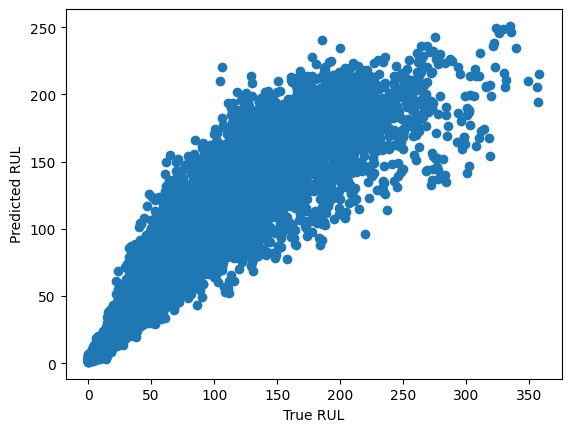

In [26]:
# Plot de relação de True Value x Predicted
plt.scatter(y_test, y_pred_test)
plt.xlabel('True RUL')
plt.ylabel('Predicted RUL')

Text(0, 0.5, 'Predicted RUL')

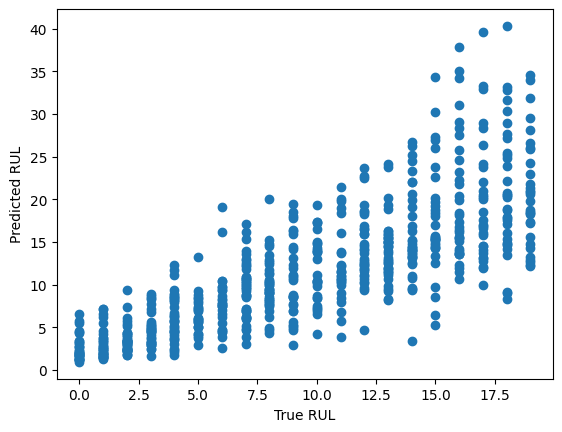

In [27]:
# Plot de relação de True Value x Predicted (dentro de 20 Ciclos)
plt.scatter(y_test[y_test<20], y_pred_test[y_test<20])
plt.xlabel('True RUL')
plt.ylabel('Predicted RUL')

# Dados de Teste - Avaliação

In [9]:
# Coleta dos dados de Teste (Avaliação)
data_test = pd.read_csv(test_path, sep=' ', header=None)
data_test.dropna(axis=1, how='all', inplace=True)

# renomear os dados
for nameColumn in conf_features['data']['columns_names'].keys():
    first_columns = conf_features['data']['columns_names'][nameColumn]['first']
    last_columns = conf_features['data']['columns_names'][nameColumn]['last']
    for idx, nColumn in enumerate(range(first_columns, last_columns+1)):
        if first_columns == last_columns:
            data_test.rename(columns={nColumn: nameColumn}, inplace=True)
        else:
            data_test.rename(columns={nColumn: f'{nameColumn}{idx+1}'}, inplace=True)

# visualizar os dados originais
data_test

,Asset id,runtime,Setting1,Setting2,Setting3,Tag1,Tag2,Tag3,Tag4,Tag5,...,Tag12,Tag13,Tag14,Tag15,Tag16,Tag17,Tag18,Tag19,Tag20,Tag21
0,1,1,0.0023,0.0003,100.0,518.67,643.02,1585.29,1398.21,14.62,...,521.72,2388.03,8125.55,8.4052,0.03,392,2388,100.0,38.86,23.3735
1,1,2,-0.0027,-0.0003,100.0,518.67,641.71,1588.45,1395.42,14.62,...,522.16,2388.06,8139.62,8.3803,0.03,393,2388,100.0,39.02,23.3916
2,1,3,0.0003,0.0001,100.0,518.67,642.46,1586.94,1401.34,14.62,...,521.97,2388.03,8130.10,8.4441,0.03,393,2388,100.0,39.08,23.4166
3,1,4,0.0042,0.0000,100.0,518.67,642.44,1584.12,1406.42,14.62,...,521.38,2388.05,8132.90,8.3917,0.03,391,2388,100.0,39.00,23.3737
4,1,5,0.0014,0.0000,100.0,518.67,642.51,1587.19,1401.92,14.62,...,522.15,2388.03,8129.54,8.4031,0.03,390,2388,100.0,38.99,23.4130
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13091,100,194,0.0049,0.0000,100.0,518.67,643.24,1599.45,1415.79,14.62,...,520.69,2388.00,8213.28,8.4715,0.03,394,2388,100.0,38.65,23.1974
13092,100,195,-0.0011,-0.0001,100.0,518.67,643.22,1595.69,1422.05,14.62,...,521.05,2388.09,8210.85,8.4512,0.03,395,2388,100.0,38.57,23.2771
13093,100,196,-0.0006,-0.0003,100.0,518.67,643.44,1593.15,1406.82,14.62,...,521.18,2388.04,8217.24,8.4569,0.03,395,2388,100.0,38.62,23.2051
13094,100,197,-0.0038,0.0001,100.0,518.67,643.26,1594.99,1419.36,14.62,...,521.33,2388.08,8220.48,8.4711,0.03,395,2388,100.0,38.66,23.2699


In [10]:
# Criando Features - criando as freatures de métricas
window_size = 3
for coluna in data_test.columns.drop(['Asset id', 'runtime']):
    data_test[f'{coluna}-mean'] = ''
    data_test[f'{coluna}-min'] = ''
    data_test[f'{coluna}-max'] = ''
    data_test[f'{coluna}-std'] = ''

    for asset in data_test['Asset id'].unique():
        data_test.loc[data_test['Asset id'] == asset, f'{coluna}-mean'] = data_test.loc[data_test['Asset id'] == asset, coluna].rolling(window_size).mean()
        data_test.loc[data_test['Asset id'] == asset, f'{coluna}-min'] = data_test.loc[data_test['Asset id'] == asset, coluna].rolling(window_size).min()
        data_test.loc[data_test['Asset id'] == asset, f'{coluna}-max'] = data_test.loc[data_test['Asset id'] == asset, coluna].rolling(window_size).max()
        data_test.loc[data_test['Asset id'] == asset, f'{coluna}-std'] = data_test.loc[data_test['Asset id'] == asset, coluna].rolling(window_size).std()

data_test

,Asset id,runtime,Setting1,Setting2,Setting3,Tag1,Tag2,Tag3,Tag4,Tag5,...,Tag19-max,Tag19-std,Tag20-mean,Tag20-min,Tag20-max,Tag20-std,Tag21-mean,Tag21-min,Tag21-max,Tag21-std
0,1,1,0.0023,0.0003,100.0,518.67,643.02,1585.29,1398.21,14.62,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,2,-0.0027,-0.0003,100.0,518.67,641.71,1588.45,1395.42,14.62,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1,3,0.0003,0.0001,100.0,518.67,642.46,1586.94,1401.34,14.62,...,100.0,0.0,38.986667,38.86,39.08,0.113725,23.3939,23.3735,23.4166,0.021642
3,1,4,0.0042,0.0000,100.0,518.67,642.44,1584.12,1406.42,14.62,...,100.0,0.0,39.033333,39.0,39.08,0.041633,23.393967,23.3737,23.4166,0.021548
4,1,5,0.0014,0.0000,100.0,518.67,642.51,1587.19,1401.92,14.62,...,100.0,0.0,39.023333,38.99,39.08,0.049329,23.4011,23.3737,23.4166,0.023797
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13091,100,194,0.0049,0.0000,100.0,518.67,643.24,1599.45,1415.79,14.62,...,100.0,0.0,38.683333,38.63,38.77,0.075719,23.2358,23.1974,23.2952,0.052172
13092,100,195,-0.0011,-0.0001,100.0,518.67,643.22,1595.69,1422.05,14.62,...,100.0,0.0,38.616667,38.57,38.65,0.041633,23.256567,23.1974,23.2952,0.052033
13093,100,196,-0.0006,-0.0003,100.0,518.67,643.44,1593.15,1406.82,14.62,...,100.0,0.0,38.613333,38.57,38.65,0.040415,23.226533,23.1974,23.2771,0.043961
13094,100,197,-0.0038,0.0001,100.0,518.67,643.26,1594.99,1419.36,14.62,...,100.0,0.0,38.616667,38.57,38.66,0.045092,23.2507,23.2051,23.2771,0.039655


In [11]:
# Organização para selecionar ultimo momento de cada Ativivo (Asset)
X_test_test = pd.DataFrame([], columns=data_test.columns)
for asset in data_test['Asset id'].unique():
    X_test_test = pd.concat([X_test_test, 
                             pd.DataFrame(data_test[data_test['Asset id']==asset].iloc[-1]).T])
X_test_test

,Asset id,runtime,Setting1,Setting2,Setting3,Tag1,Tag2,Tag3,Tag4,Tag5,...,Tag19-max,Tag19-std,Tag20-mean,Tag20-min,Tag20-max,Tag20-std,Tag21-mean,Tag21-min,Tag21-max,Tag21-std
30,1,31,-0.0006,0.0004,100.0,518.67,642.58,1581.22,1398.91,14.62,...,100.0,0.0,38.973333,38.81,39.09,0.145717,23.374733,23.3552,23.4069,0.02807
79,2,49,0.0018,-0.0001,100.0,518.67,642.55,1586.59,1410.83,14.62,...,100.0,0.0,38.893333,38.81,38.99,0.090738,23.283367,23.2618,23.2965,0.018825
205,3,126,-0.0016,0.0004,100.0,518.67,642.88,1589.75,1418.89,14.62,...,100.0,0.0,38.723333,38.56,38.93,0.188768,23.245433,23.227,23.274,0.025085
311,4,106,0.0012,0.0004,100.0,518.67,642.78,1594.53,1406.88,14.62,...,100.0,0.0,38.706667,38.58,38.87,0.148436,23.261,23.2524,23.2725,0.010359
409,5,98,-0.0013,-0.0004,100.0,518.67,642.27,1589.94,1419.36,14.62,...,100.0,0.0,38.76,38.68,38.85,0.08544,23.313167,23.2262,23.4117,0.093289
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12545,96,97,-0.0006,0.0003,100.0,518.67,642.3,1590.88,1397.94,14.62,...,100.0,0.0,39.03,38.96,39.12,0.081854,23.3854,23.2993,23.4606,0.081201
12679,97,134,0.0013,-0.0001,100.0,518.67,642.59,1582.96,1410.92,14.62,...,100.0,0.0,38.823333,38.61,39.03,0.210079,23.368567,23.2953,23.4391,0.071939
12800,98,121,0.0017,0.0001,100.0,518.67,642.68,1599.51,1415.47,14.62,...,100.0,0.0,38.75,38.72,38.77,0.026458,23.2948,23.2574,23.3608,0.057327
12897,99,97,0.0047,-0.0,100.0,518.67,642.0,1585.03,1397.98,14.62,...,100.0,0.0,38.996667,38.95,39.07,0.064291,23.3657,23.2856,23.452,0.083373


In [18]:
# Load do modelo de regressão, para predição de RUL
reg = joblib.load('./models/prediction_RandomForestRegressor.pkl')
# Realização da predição
y_pred_test = reg.predict(X_test_test.drop(columns=['Asset id']))
# Salvar o resultado
y_pred_test = pd.DataFrame(y_pred_test, columns=['predicted'])
y_pred_test.to_csv('./predicted_RUL.csv', index=False)
y_pred_test

,predicted
0,178.084496
1,153.757248
2,47.327518
3,80.152307
4,97.744950
...,...
95,137.138607
96,80.820000
97,82.504293
98,144.172146


In [15]:
# Load do modelo de classificação, para classificação de Close to Failure (dentro de 20 Ciclos para Falhar)
clf = joblib.load('./models/classification_Random Forest.pkl')
# Realização da classificação
y_clf_test = clf.predict_proba(X_test_test.drop(columns=['Asset id']))
# Salvar o resultado
y_clf_test = pd.DataFrame(y_clf_test, columns=['predicted', 'false'])
y_clf_test['predicted'].to_csv('./predicted_CloseToFailure.csv', index=False)
# y_clf_test

# Fim !